In [3]:
import tensorflow as tf
from tensorflow.keras import models, layers
import matplotlib.pyplot as plt
# we predict in tf i.e. send the image as tf and use numpy only when need to show some output

In [4]:
IMAGE_SIZE= 256
BATCH_SIZE = 32
CHANNELS=3

In [5]:
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    "PlantVillage",
    shuffle = True,
    image_size = (IMAGE_SIZE,IMAGE_SIZE),
    batch_size= BATCH_SIZE
)

Found 16009 files belonging to 10 classes.


In [6]:
class_names = dataset.class_names
class_names

['Tomato_Bacterial_spot',
 'Tomato_Early_blight',
 'Tomato_Late_blight',
 'Tomato_Leaf_Mold',
 'Tomato_Septoria_leaf_spot',
 'Tomato_Spider_mites_Two_spotted_spider_mite',
 'Tomato__Target_Spot',
 'Tomato__Tomato_YellowLeaf__Curl_Virus',
 'Tomato__Tomato_mosaic_virus',
 'Tomato_healthy']

In [7]:
len(dataset)

501

In [8]:
for image_batch, label_batch in dataset.take(1):
    print(image_batch.shape)
    print(label_batch.numpy())

(32, 256, 256, 3)
[3 4 6 4 0 7 2 2 4 7 0 4 7 5 7 7 2 9 6 0 0 7 9 7 1 9 2 5 9 0 4 0]


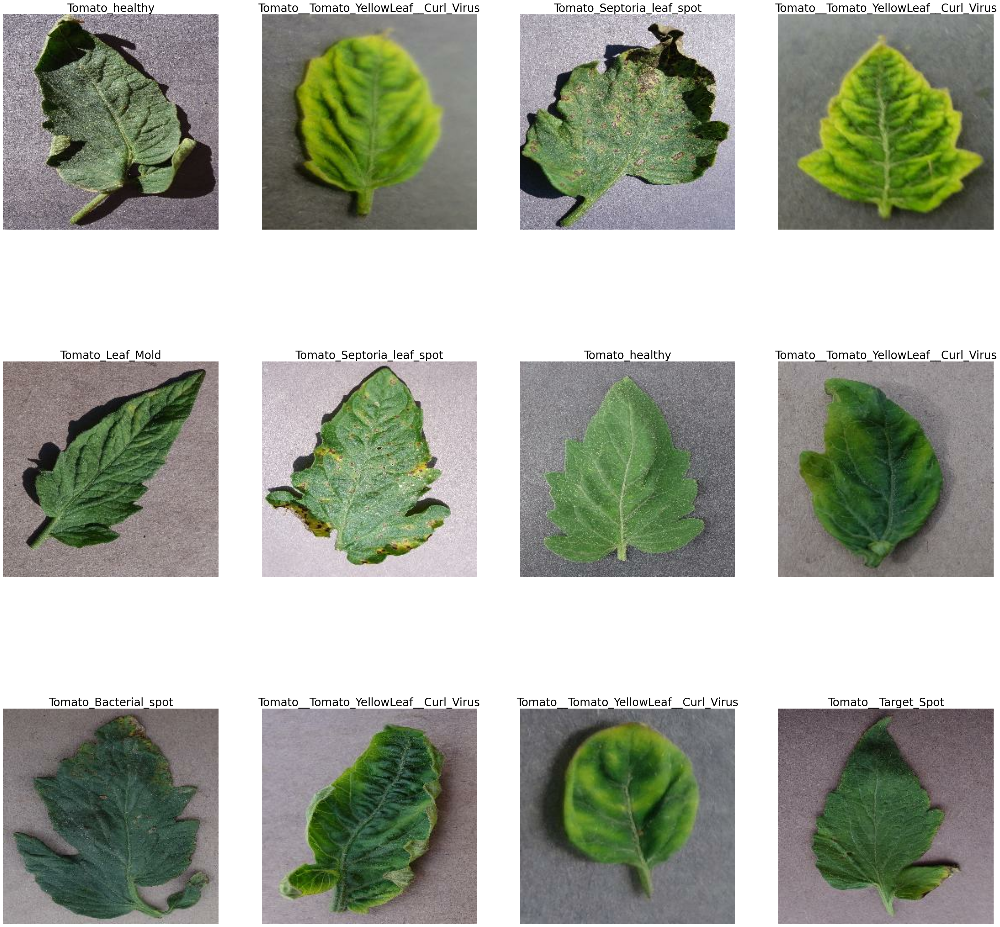

In [9]:
plt.figure(figsize=(40,40))
for image_batch, label_batch in dataset.take(1):
    for i in range(12):
        ax = plt.subplot(3,4, i+1)
        plt.imshow(image_batch[i].numpy().astype("uint8"))
        plt.title(class_names[label_batch[i]], fontsize=25)
        plt.axis("off")


In [10]:
def get_dataset_partitions_tf(ds, train_split = 0.8, val_split=0.1, test_split=0.1,shuffle=True,shuffle_size=10000):
        ds_size = len(ds)
        if shuffle:
            ds=ds.shuffle(shuffle_size, seed=12)
        train_size = int(train_split * ds_size)
        val_size=int(val_split * ds_size)
        train_ds=ds.take(train_size)
        val_ds = ds.skip(train_size).take(val_size)
        test_ds = ds.skip(train_size).skip(val_size)
        return train_ds, val_ds,test_ds

In [11]:
train_ds, val_ds, test_ds =get_dataset_partitions_tf(dataset)
len(train_ds)

400

In [12]:
train_ds=train_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
val_ds=val_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)
test_ds=test_ds.cache().shuffle(1000).prefetch(buffer_size=tf.data.AUTOTUNE)


In [13]:
resize_and_rescale = tf.keras.Sequential([
    layers.Resizing(IMAGE_SIZE, IMAGE_SIZE),
    layers.Rescaling(1.0/255)
])

In [14]:
data_augmentation = tf.keras.Sequential([
    layers.RandomFlip("horizontal_and_vertical"),
    layers.RandomRotation(0.2),
])

In [15]:
input_shape = (BATCH_SIZE, IMAGE_SIZE, IMAGE_SIZE, CHANNELS)
n_classes = 10

model = models.Sequential([
    resize_and_rescale,
    data_augmentation,
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dense(n_classes, activation='softmax')
])
model.build(input_shape=input_shape)


In [16]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (32, 256, 256, 3)         0         
                                                                 
 sequential_1 (Sequential)   (32, 256, 256, 3)         0         
                                                                 
 conv2d (Conv2D)             (32, 254, 254, 32)        896       
                                                                 
 max_pooling2d (MaxPooling2  (32, 127, 127, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (32, 125, 125, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (32, 62, 62, 64)          0         
 g2D)                                                 

In [17]:
model.compile(
    optimizer='adam',
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

In [18]:
history = model.fit(
    train_ds,
    batch_size=BATCH_SIZE,
    validation_data=val_ds,
    verbose=1,
    epochs=10,
)


Epoch 1/10


2024-07-09 22:49:05.001443: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:11: Filling up shuffle buffer (this may take a while): 416 of 10000
2024-07-09 22:49:09.779543: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.
2024-07-09 22:49:10.067824: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


400/400 [==============================] - ETA: 0s - loss: 1.0186 - accuracy: 0.6388

2024-07-09 22:55:32.595187: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:11: Filling up shuffle buffer (this may take a while): 324 of 10000
2024-07-09 22:55:48.815116: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.
2024-07-09 22:55:49.287011: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:21: Filling up shuffle buffer (this may take a while): 1 of 1000
2024-07-09 22:55:49.323786: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


400/400 [==============================] - 429s 1s/step - loss: 1.0186 - accuracy: 0.6388 - val_loss: 0.9984 - val_accuracy: 0.6737
Epoch 2/10
400/400 [==============================] - 384s 960ms/step - loss: 0.5337 - accuracy: 0.8116 - val_loss: 1.3111 - val_accuracy: 0.6275
Epoch 3/10
400/400 [==============================] - 397s 992ms/step - loss: 0.4013 - accuracy: 0.8595 - val_loss: 1.0598 - val_accuracy: 0.7006
Epoch 4/10
400/400 [==============================] - 406s 1s/step - loss: 0.3500 - accuracy: 0.8777 - val_loss: 0.4029 - val_accuracy: 0.8550
Epoch 5/10
400/400 [==============================] - 419s 1s/step - loss: 0.3060 - accuracy: 0.8911 - val_loss: 0.7035 - val_accuracy: 0.8231
Epoch 6/10
400/400 [==============================] - 411s 1s/step - loss: 0.2464 - accuracy: 0.9130 - val_loss: 0.4744 - val_accuracy: 0.8394
Epoch 7/10
400/400 [==============================] - 408s 1s/step - loss: 0.2105 - accuracy: 0.9280 - val_loss: 1.0770 - val_accuracy: 0.7962
Epoc

In [19]:
scores=model.evaluate(test_ds)
scores

2024-07-09 23:56:17.367369: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:11: Filling up shuffle buffer (this may take a while): 317 of 10000
2024-07-09 23:56:27.505123: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:422] ShuffleDatasetV3:11: Filling up shuffle buffer (this may take a while): 459 of 10000
2024-07-09 23:56:30.998581: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.
2024-07-09 23:56:31.378297: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:452] Shuffle buffer filled.


51/51 [==============================] - 40s 296ms/step - loss: 0.3552 - accuracy: 0.8897


[0.35520219802856445, 0.8897058963775635]

In [20]:
history.params

{'verbose': 1, 'epochs': 10, 'steps': 400}

In [21]:
len(history.history["accuracy"])

10

In [22]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']


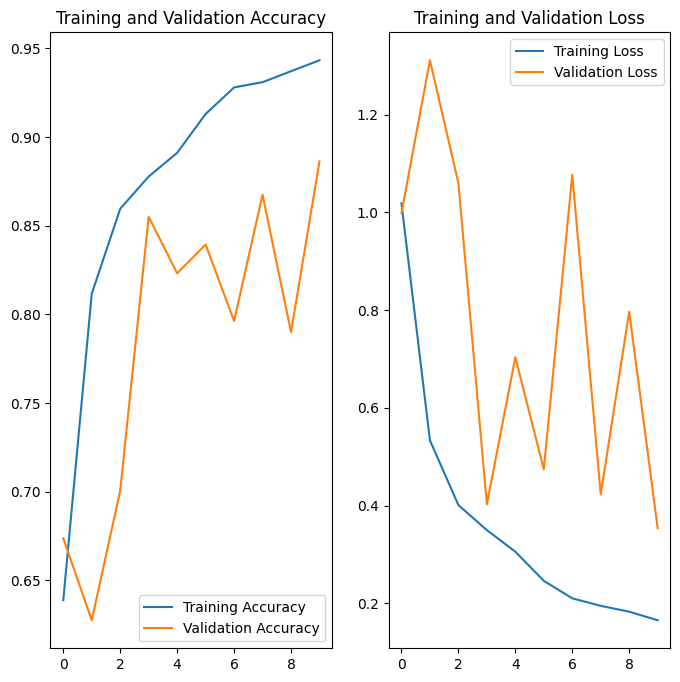

In [23]:
plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(range(10), acc, label='Training Accuracy')
plt.plot(range(10), val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(range(10), loss, label='Training Loss')
plt.plot(range(10), val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

first image to predict
actual label: Tomato_Bacterial_spot
1/1 [==============================] - 1s 522ms/step
predicted label: Tomato_Bacterial_spot


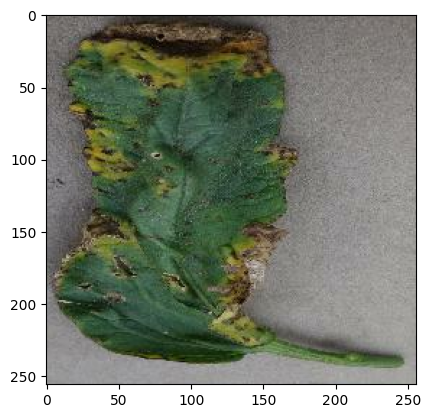

In [24]:
import numpy as np
for images_batch, labels_batch in test_ds.take(1):
    first_image = images_batch[0].numpy().astype('uint8')
    first_label = labels_batch[0]
    
    print("first image to predict")
    plt.imshow(first_image)
    print("actual label:",class_names[first_label])
    
    batch_prediction = model.predict(images_batch)
    print("predicted label:",class_names[np.argmax(batch_prediction[0])])

In [25]:
def predict(model, img):
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)

    predictions = model.predict(img_array)

    predicted_class = class_names[np.argmax(predictions[0])]
    confidence = round(100 * (np.max(predictions[0])), 2)
    return predicted_class, confidence

1/1 [==============================] - 0s 17ms/step


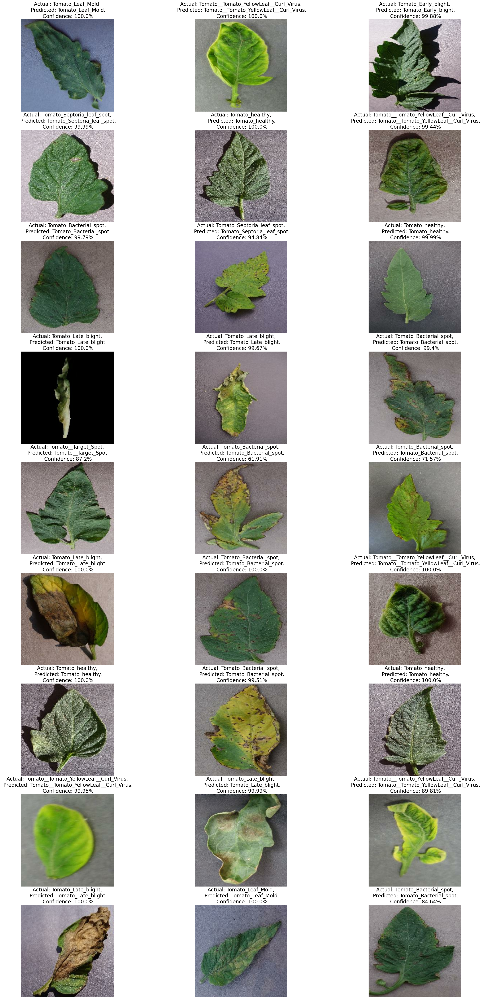

In [26]:
plt.figure(figsize=(35, 70))
for images, labels in test_ds.take(1):
    for i in range(27):
        ax = plt.subplot(9, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        
        predicted_class, confidence = predict(model, images[i].numpy())
        actual_class = class_names[labels[i]] 
        
        plt.title(f"Actual: {actual_class},\n Predicted: {predicted_class}.\n Confidence: {confidence}%", fontsize=20)
        
        plt.axis("off")
       

In [31]:
model.save("../tomatoes.h5")

In [ ]:
import os

# Find the next model version number
model_version = max([int(i) for i in os.listdir("../models_tomato") if i.isdigit()] + [0]) + 1

# Save the model with a .keras extension
model.save(f"../models_tomato/{model_version}.keras")